# Homework 7
**Total Points: 5**

**Instructions:**
1. Complete parts 1 through 5, filling in code or responses where marked with `# YOUR CODE HERE` or `# YOUR ANALYSIS HERE`.
2. The libraries you need have already been coded. Do not import additional libraries or move import commands.
3. When finished, run the full notebook by selecting <b>Kernel > Restart & Run All</b>. </li>
4. Submit this completed notebook file to <b>NYU Classes</b>. </li>**(Important: Only submit your .ipynb file! Do not submit the entire dataset.)**

In this assignment you will test two different techniques to estimate beat positions: spectral flux and a recurrent neural network. This assignment uses *GuitarSet*, a dataset of solo guitar recordings, and accompanying ground truth beat annotations. The beats are included with this assignment and the GuitarSet audio files can be downloaded separately.

<blockquote>
Q. Xi, R. Bittner, J. Pauwels, X. Ye, and J. P. Bello, "Guitarset: A Dataset for Guitar Transcription", in 19th International Society for Music Information Retrieval Conference, Paris, France, Sept. 2018.
</blockquote>

This assignment uses two new libraries, `madmom`, which contains additional signal processing tools, and `mir_eval` to calculate f_measure for beat tracking. You can install both from the command line using `pip`. More information about madmom is available here: https://madmom.readthedocs.io/ 

**Grading:** Each part is worth 1 point.

## Prologue: Download GuitarSet and Beat Position Data

The data you will need is a folder containing .wav audio files, and a separate folder containing .txt files with times indicating the ground truth beats. The text files are in `GuitarSet_beats.zip` as part of this assignment The GuitarSet audio files are available here:

https://zenodo.org/record/3371780

**You don't need the entire dataset.** Only download the file `audio_mono-mic.zip`, which is about 670MB. 

Download and extract both the dataset and the beat position data. Place the data into folders in the same directory as your `Homework-7.ipynb` file, such that the folder stucture is:

`
 .
 <--   Homework-7.ipynb
 <--   GuitarSet_beats
 |     <--   *.txt files      
 <--   audio_mono-mic   
 |     <--   *.wav files
`

The `*.wav` audio files contain guitar recordings from 6 different players and a variety of speeds and styles. Each audio file has a matching filename `*.txt`, which contains ground truth times for each beat. 

To get all the filenames in a specific directory, use the `os` library as follows:

`
for filename in os.listdir("GuitarSet_beats/"):
    if filename.endswith(".txt"):
        ...
`

To import a text file as a numpy array, use numpy's `loadtxt`.

In [1]:
import librosa
import IPython
import os
import numpy as np
import madmom
import matplotlib.pyplot as plt
from mir_eval.beat import f_measure

## Part 1: Estimate Beats

Write a function `estimate_beats()` that estimates beat positions using one of two methods:

- a spectral flux onset novelty curve
- a recurrent neural network

Using the novelty curve from one of the above methods, generate a tempogram and calculate the predominant local pulse. You may use Librosa's `plp` and `onset_strength` functions, and madmom's `RNNBeatProcessor`. Do not use Librosa's `beat_track`.

In a recurrent neural network (RNN), the output is "remembered" and used when calculating subsequent outputs; it is useful for series data such as with speech recognition. For example, predicting the next day of the week is determined by the current day (if the previous output is "Wednesday", the next output should be "Thursday").  In our case, the RNN will be used to generate a novelty curve, where the ouput is the probability of a beat at a particular frame. More information is available in madmom's documentation: https://madmom.readthedocs.io/en/latest/modules/features/beats.html.

In [2]:
def estimate_beats(audio_path, onset_type, plot=False):
    """Compute beat positions using either a spectral flux or a machine learned onset novelty function,
    followed by computing a tempogram and PLP.
    
    Parameters
    ----------
    audio_path : str
        Path to input audio file
    onset_type : str
        One of 'spectral_flux' or 'machine_learning'
    plot : bool
        If True, plots the onset novelty curve and the estimated beat positions.

    Returns
    -------
    beat_times : 1-d np.array
        Array of time stamps of the estimated beats in seconds.

    """
    # Load data
    data, sr = librosa.load( audio_path )
    T = len( data ) / sr 
    
    # Compute beats using spectral flux method
    if onset_type == "spectral_flux":
        
        # Compute onset envelope for use in librosa's predominant local pulse 
        onset_env = librosa.onset.onset_strength(y = data, sr = sr)
        
        # Use the envelope computed to generate predominant local pulse
        pulse = librosa.beat.plp(onset_envelope = onset_env, sr = sr)
        
        # Obtain the indice of local maxima points
        beats_plp = np.nonzero( librosa.util.localmax(pulse) )

        # Generate time vector the same length as all pulses
        times_sf = np.linspace( 0, T, len( pulse ) )
# ------------------------------------------------------------------------------------------ #
        # Uncomment to use a log-based prior tempo distribution around 120 bpm. 
        # Works better if we know the specific bpm range
        
#         import scipy.stats
#         prior = scipy.stats.lognorm(loc=np.log(120), scale=120, s=1)
#         pulse = librosa.beat.plp(onset_envelope = onset_env, sr = sr, prior = prior)
#         beats_plp = np.nonzero( librosa.util.localmax(pulse) )
#         times_sf = np.linspace( 0, T, len( pulse ) )
# ------------------------------------------------------------------------------------------ #   

        # Plotting
        if plot: 
            plt.figure(figsize = (20,8))
            times_onset = np.linspace( 0, T, len( onset_env ) )
            plt.plot(times_onset, librosa.util.normalize(onset_env)*.2, color = 'b', label = "Onset Envelope")
            plt.plot(times_sf, librosa.util.normalize(pulse), color ='g', label='PLP')
            plt.vlines(times_sf[beats_plp], 0, pulse.max(), alpha=0.5, color='r', linestyle='--', label='PLP Beats')
            plt.legend()
            plt.xlabel("Time (seconds)")
            plt.title('librosa.beat.plp')
            
        return times_sf[beats_plp]

    # Compute beats using RNN
    if onset_type == "machine_learning": 
        
        # Initialize the RNN processor from madmom
        RNN_beat_proc = madmom.features.beats.RNNBeatProcessor()
        
        # Calculate the probablity at 100 frames per second
        rnn_pulse_probs = RNN_beat_proc( audio_path )
        
        # Using PLP to obtain beat locations from the probability curve.
        # Then converting the results to frame numbers
        beats_rnn = np.nonzero( librosa.util.localmax(
            librosa.beat.plp( onset_envelope = rnn_pulse_probs, sr = sr ) ) )
        
#         # My previous method ( noted in analysis below )
#         beats_rnn = np.nonzero(  rnn_pulse_probs > 0.1  ) 
        
        # Normalize the x-axis
        times_rnn = np.linspace( 0, T, len( rnn_pulse_probs ) )
        if plot:
            plt.figure(figsize = (20,8))
            plt.plot(times_rnn, rnn_pulse_probs, label='RNN Probability')
            plt.vlines(times_rnn[beats_rnn], 0, rnn_pulse_probs.max(), 
                       alpha=0.5, color='r', linestyle='--', label='RNN Beats')
            plt.legend()
            plt.ylabel("Probability")
            plt.xlabel("Time (seconds)")
            plt.title('RNNBeatProcessor')
        return times_rnn[beats_rnn]

    
# Testing one two ...

# estimate_beats("audio_mono-mic/05_Jazz1-130-D_solo_mic.wav", "machine_learning", True)
# plot_and_sonify_outputs("05_Jazz1-130-D_solo_mic")
# IPython.display.Audio("audio_mono-mic/05_Jazz1-130-D_solo_mic.wav")

## Part 2: Evaluate Beats

Evaluate the beat estimates for each track in GuitarSet using mir_eval's `f_measure(reference_beats, estimated_beats, f_measure_threshold=0.07)`. Do this by creating two dictionaries, one for SF beats and one for the ML beats. The keys of the dictionaries should be the GuitarSet file name without the extension (`00_BN1-129-Eb_solo`), and the value for each key should be the f-measure, which should evaluate the predicted beats vs. the ground truth beats for each method.

In [3]:
scores_sf = {} 
scores_ml = {}

for filename in os.listdir("GuitarSet_beats/"):
    if filename.endswith(".txt"):
        reference_beats = np.loadtxt( "GuitarSet_beats/" + filename )
        audio_filename = filename[:-4] + ".wav"
        estimated_beats_sf = estimate_beats("audio_mono-mic/" + audio_filename, "spectral_flux", False)
        estimated_beats_rnn = estimate_beats("audio_mono-mic/" + audio_filename, "machine_learning", False)
        scores_sf[ filename[:-4] ] = f_measure( reference_beats, estimated_beats_sf )
        scores_ml[ filename[:-4] ] = f_measure( reference_beats, estimated_beats_rnn )

In [4]:
# Run this code to test your dictionaries

example_trackid = "00_BN1-129-Eb_comp_mic"
print("The spectral flux beats f-measure for {} is {}".format(example_trackid, scores_sf[example_trackid]))
print("The machine learned beats f-measure for {} is {}".format(example_trackid, scores_ml[example_trackid]))
print("")
print("The average f-measure for spectral flux beats is {}".format(np.mean(list(scores_sf.values()))))
print("The average f-measure for machine learned beats is {}".format(np.mean(list(scores_ml.values()))))

The spectral flux beats f-measure for 00_BN1-129-Eb_comp_mic is 0.6344827586206896
The machine learned beats f-measure for 00_BN1-129-Eb_comp_mic is 0.5839416058394161

The average f-measure for spectral flux beats is 0.5158322803670138
The average f-measure for machine learned beats is 0.5974392311203802


## Part 3: Plot Results

Plot overall results and results of specific groups (player, style, tempo, and mode) by splitting the data. This is useful to identify trends in addition to the overall results. The audio and data filenames contain information needed to split the tracks (you may find `split()` to be useful) and can be parsed as follows:

`<player id>_<style>-<tempo>-<key>_<solo or comp>_mic.txt/wav`

Plot the scores as boxplots using [matplotlib.pyplot.boxplot](https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.boxplot.html). The boxplots will show the median, quantiles, and range of the scores across tracks. All of your plots should have axis labels, titles and legends.

Create each of the following plots:

1. **Overall scores**: A single figure with two boxplots. One using the scores for all tracks for SF beats and one for ML beats.
2. **Scores by player**: A figure with two subplots (one row, two columns). The left subplot should have scores for SF beats and the right for ML beats. Each subplot should contain 6 boxplots, where each boxplot is computed for the tracks played by one player.
3. **Scores by playing mode**: A figure with two subplots (one row, two columns). The left subplot should have scores for SF beats and the right for ML beats. Each subplot should contain 2 boxplots, where each boxplot is computed for the playing mode ('solo' or 'comp').
4. **Scores by genre/style**: A figure with two subplots (one row, two columns). The left subplot should have scores for SF beats and the right for ML beats. Each subplot should contain 5 boxplots, where each boxplot is computed for the style (Bossa Nova, Funk, ...).
5. **Scores by tempo**: A figure with two subplots (one row, two columns). The left subplot should have scores for SF beats and the right for ML beats. Each subplot should contain one **scatter plot** (not a boxplot), which has tempo in BPM as the x-axis and f-measure as the y-axis.

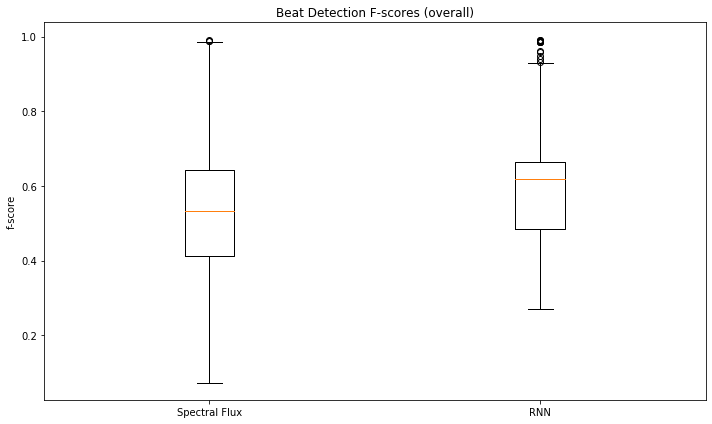

In [5]:
# Overall scores

sf = list(scores_sf.values())
ml = list(scores_ml.values())

data = [ sf, ml ]
plt.figure( figsize = ( 10, 6 ) )
plt.ylabel( "f-score")
plt.title( "Beat Detection F-scores (overall)" )
plt.boxplot( data, labels = ["Spectral Flux", "RNN"] )
plt.tight_layout()

plt.show()

In [6]:
def split_by_player(scores_dictionary):
    """Split scores by player id

    Parameters
    ----------
    scores_dictionary : dict
        Dictionary of scores keyed by track_id

    Returns
    -------
    player_scores : dict
        Dictionary with player ids as keys and a
        dictionary of scores keyed by track_id as values

    """
    player_scores = {}
    
    # Convert dictionary keys to a list
    track_ids = list( scores_dictionary.keys() )
    player_ids = set( [ track_id.split('_')[0] for track_id in track_ids] )
    

    for player_id in player_ids:
        player_scores[ player_id ] = { track_id : scores_dictionary[track_id] for
                                      track_id in track_ids if
                                      track_id.split("_")[0] == player_id }
        
    return player_scores

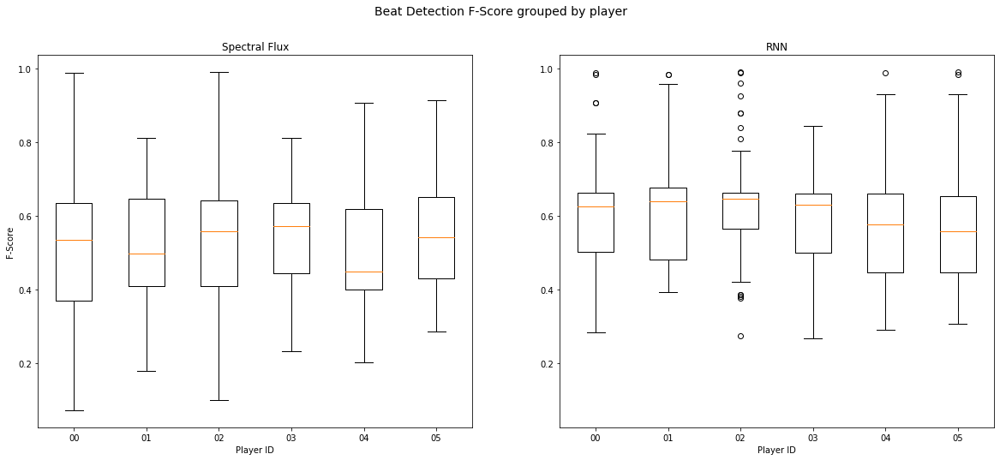

In [7]:
player_scores_sf = split_by_player(scores_sf)
player_scores_ml = split_by_player(scores_ml)

# Scores by player figure

# Initialize player data lists
def get_data_for_plotting ( scores ):
    data = [ key_value_pair for key_value_pair in sorted(scores.items()) ]
#     display(data[0][1])
    for i in range ( len(data) ):
        track_ids = [ key for key in data[i][1].keys() ]
        data[i] = [ data[i][1][track_id] for track_id in track_ids ]
    
    return data

data_sf = get_data_for_plotting( player_scores_sf )
data_ml = get_data_for_plotting( player_scores_ml )

plt.figure(figsize = (20, 8))
ax1 = plt.subplot(121)
plt.xlabel("Player ID")
plt.ylabel("F-Score")
plt.title("Spectral Flux")
plt.boxplot( data_sf, labels = [ "00", "01", "02", "03", "04", "05" ] )

ax2 = plt.subplot(122, sharey = ax1)
plt.xlabel("Player ID")
# plt.ylabel("F-Score")
plt.title("RNN")
plt.boxplot( data_ml, labels = [ "00", "01", "02", "03", "04", "05" ] )
plt.suptitle("Beat Detection F-Score grouped by player", fontsize=14)

# plt.tight_layout()
plt.show()


In [8]:
def split_by_mode(scores_dictionary):
    """Split scores by mode ('solo' or 'comp')

    Parameters
    ----------
    scores_dictionary : dict
        Dictionary of scores keyed by track_id

    Returns
    -------
    mode_scores : dict
        Dictionary with mode as keys and a
        dictionary of scores keyed by track_id as values

    """
    mode_scores = {}

    track_ids = list( scores_dictionary.keys() )
    mode_ids = set( [ track_id.split('_')[2] for track_id in track_ids] )

    for mode_id in mode_ids:
        mode_scores[ mode_id ] = { track_id : scores_dictionary[track_id] for
                                      track_id in track_ids if
                                      track_id.split("_")[2] == mode_id }
        
    return mode_scores

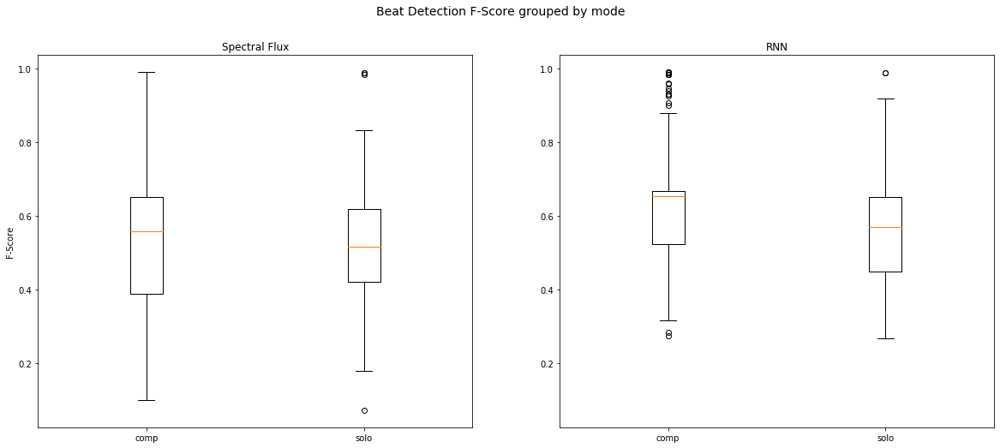

In [9]:
mode_scores_sf = split_by_mode(scores_sf)
mode_scores_ml = split_by_mode(scores_ml)

# Scores by playing mode figure
# YOUR CODE HERE
data_sf = get_data_for_plotting( mode_scores_sf )
data_ml = get_data_for_plotting( mode_scores_ml )

plt.figure(figsize = (20, 8))
ax1 = plt.subplot(121)
plt.ylabel("F-Score")
plt.title("Spectral Flux")
plt.boxplot( data_sf, labels = [ "comp", "solo"] )

ax2 = plt.subplot(122, sharey = ax1)
# plt.ylabel("F-Score")
plt.title("RNN")
plt.boxplot( data_ml, labels = [ "comp", "solo"] )
plt.suptitle("Beat Detection F-Score grouped by mode", fontsize=14)

# plt.tight_layout()
plt.show()

In [10]:
def split_by_style(scores_dictionary):
    """Split scores by style

    Parameters
    ----------
    scores_dictionary : dict
        Dictionary of scores keyed by track_id

    Returns
    -------
    style_scores : dict
        Dictionary with style as keys and a
        dictionary of scores keyed by track_id as values

    """
    style_scores = {}

    track_ids = list( scores_dictionary.keys() )
#     display(track_ids)
    style_ids =  [ track_id.split("_")[1].split("-")[0][:-1] for track_id in track_ids] 
#     print(len(style_ids))
    for style_id in style_ids:
        style_scores[ style_id ] = { track_id : scores_dictionary[track_id] for
                                      track_id in track_ids if
                                      track_id.split("_")[1].split("-")[0][:-1] == style_id }
        
    return style_scores

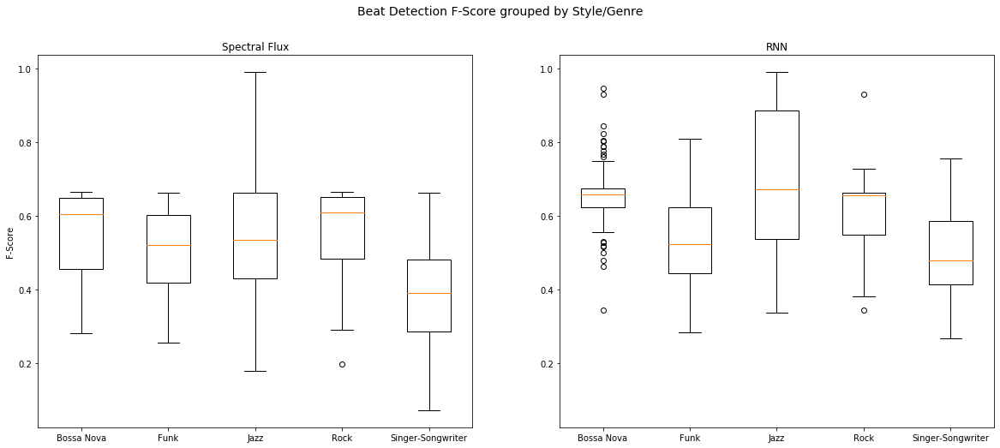

In [11]:
style_scores_sf = split_by_style(scores_sf)
style_scores_ml = split_by_style(scores_ml)

# data = [ key_value_pair for key_value_pair in sorted(style_scores_sf.items()) ]
# data
data_sf = get_data_for_plotting( style_scores_sf )
data_ml = get_data_for_plotting( style_scores_ml )

plt.figure(figsize = (20, 8))
ax1 = plt.subplot(121)
plt.ylabel("F-Score")
plt.title("Spectral Flux")
plt.boxplot( data_sf, labels = [ "Bossa Nova", "Funk", "Jazz", "Rock", "Singer-Songwriter" ] )

ax2 = plt.subplot(122, sharey = ax1)
# plt.ylabel("F-Score")
plt.title("RNN")
plt.boxplot( data_ml, labels = [ "Bossa Nova", "Funk", "Jazz", "Rock", "Singer-Songwriter" ] )
plt.suptitle("Beat Detection F-Score grouped by Style/Genre\n", fontsize=14)
# plt.tight_layout()
plt.show()

In [12]:
def get_tempo_vs_score(scores_dictionary):
    """Get score values as a function of tempo

    Parameters
    ----------
    scores_dictionary : dict
        Dictionary of scores keyed by track_id

    Returns
    -------
    tempo : np.array
        Array of tempo values with the same number of elements as scores_dictionary
    scores : np.array
        Array of scores with the same number of elements as scores_dictionary
    """
    tempos = []
    scores = []
    
    for track_id in scores_dictionary.keys():
        tempo = track_id.split("-")[1]
        tempos.append( tempo )
        score = scores_dictionary[ track_id ]
        scores.append( score )
        
    tempo_score_pair = zip( tempos , scores )
    scores_sorted = [ score for _, score in sorted(tempo_score_pair, key = lambda pair: int( pair[0]) ) ]
    tempos_sorted = sorted( tempos, key = int )

    return np.array(tempos_sorted), np.array(scores_sorted)

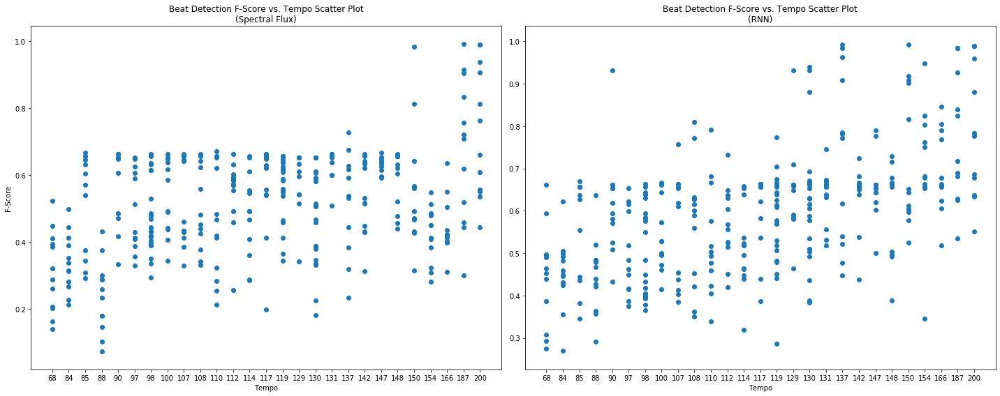

In [13]:
tempo_sf, score_by_tempo_sf = get_tempo_vs_score(scores_sf)
tempo_ml, score_by_tempo_ml = get_tempo_vs_score(scores_ml)

# Scores by tempo figure

plt.figure(figsize = (20, 8))
plt.subplot(121)
plt.ylabel("F-Score")
plt.xlabel("Tempo")
plt.title("Beat Detection F-Score vs. Tempo Scatter Plot\n(Spectral Flux)")
plt.scatter( tempo_sf, score_by_tempo_sf)

plt.subplot(122)
plt.title("Beat Detection F-Score vs. Tempo Scatter Plot\n(RNN)")
plt.xlabel("Tempo")
plt.scatter( tempo_ml, score_by_tempo_ml )
plt.tight_layout()

plt.show()

## Part 4: Plot & Sonify Individual Results

Write a function `plot_and_sonify_outputs()` that computes, plots and sonifies the outputs of `estimate_beats()`. The function should do the following:

1. Plot the spectral flux novelty curve and the estimated beats as vertical lines.
2. Plot the machine learned novelty curve and the estimated beats as vertical lines.
3. Plot the audio and the reference beats as vertical lines.
    
Also generate a click track at the beat positions (using `librosa.clicks`) and add the resulting audio file to the original audio for each of:

1. the SF beats
2. the ML beats
3. the reference beats
    
In total, for one track_id, this function should create 3 plots and 3 playable audio widgets. To allow more than one audio widget to appear:


`audio1 = IPython.display.Audio(...)
audio2 = IPython.display.Audio(...)
IPython.display.display(audio1)
IPython.display.display(audio2)
`

In [21]:
# Helper function I defined to generate the mixed click track with original soundfile
def mix ( data1, data2 ):
    """Mixes two audio signals together
    
    Parameters
    ----------
    data1: audio data (numpy array)
    
    data2: audio data (numpy array)

    Returns
    -------
    a single numpy array of mixed signal  
    """
    
    length1 = len(data1)
    length2 = len(data2)
    
    if length1 > length2:
        data1[ : length2] += data2
    else:
        data1 += data2[ : length1]

    return data1

def plot_and_sonify_outputs(track_id):
    """For a given track ID, compute, plot and sonify results.
    
    Parameters
    ----------
    track_id : str
        GuitarSet track_id

    Returns
    -------
    None

    """
    
    # Get the estimated beat time arrays and reference beat times. 
    audio_path = "audio_mono-mic/" + track_id + ".wav"
    reference_path = "GuitarSet_beats/" + track_id + ".txt"
    beat_times_sf = estimate_beats(audio_path, "spectral_flux", plot = True)
    beat_times_ml = estimate_beats(audio_path, "machine_learning", plot = True)
    reference_beats = np.loadtxt( reference_path )
    
    # Get data and time information of audio file
    data, fs = librosa.load( audio_path )
    T = len( data ) / fs
    time = np.linspace( 0, T, len( data ))
    
    # Generate waveform plot
    reference_beats_in_samples = [ int( beat_time * fs ) for beat_time in reference_beats ]
    plt.figure(figsize = (20,8))
    plt.title("Waveform")
    plt.xlabel("Time (seconds)")
    plt.plot( time, data, label = "Waveform" )
    plt.vlines(time[reference_beats_in_samples], 
               -np.abs(data).max(), data.max(), alpha=0.5, 
               color='r', linestyle='--', label='Reference Beats')
    plt.legend()
    
    # Generate click track
    sf_click = librosa.clicks( times = beat_times_sf, sr = fs )
    ml_click = librosa.clicks( times = beat_times_ml, sr = fs )
    reference_click = librosa.clicks( times = reference_beats, sr = fs )
    
    # Mix click track with origial audio file
    sf_click = mix(sf_click, data)
    ml_click = mix(ml_click, data)
    reference_click = mix(reference_click, data)
    
    # Play audio
    sf_click_audio = IPython.display.Audio(sf_click, rate = fs)
    ml_click_audio = IPython.display.Audio(ml_click, rate = fs)
    reference_click_audio = IPython.display.Audio(reference_click, rate = fs)
    print("Spectral Flux beat prediction:")
    IPython.display.display(sf_click_audio)
    print("RNN beat prediction:")
    IPython.display.display(ml_click_audio)
    print("Reference beats:")
    IPython.display.display(reference_click_audio)

    return

In [22]:
# run this and the cells below 
best_track_sf = max(scores_sf, key=scores_sf.get)  # the track with the best score for SF Beats
best_track_ml = max(scores_ml, key=scores_ml.get)  # the track with the best score for ML Beats
worst_track_sf = min(scores_sf, key=scores_sf.get)  # the track with the worst score for SF Beats
worst_track_ml = min(scores_ml, key=scores_ml.get)  # the track with the worst score for ML Beats

Spectral Flux beat prediction:


RNN beat prediction:


Reference beats:


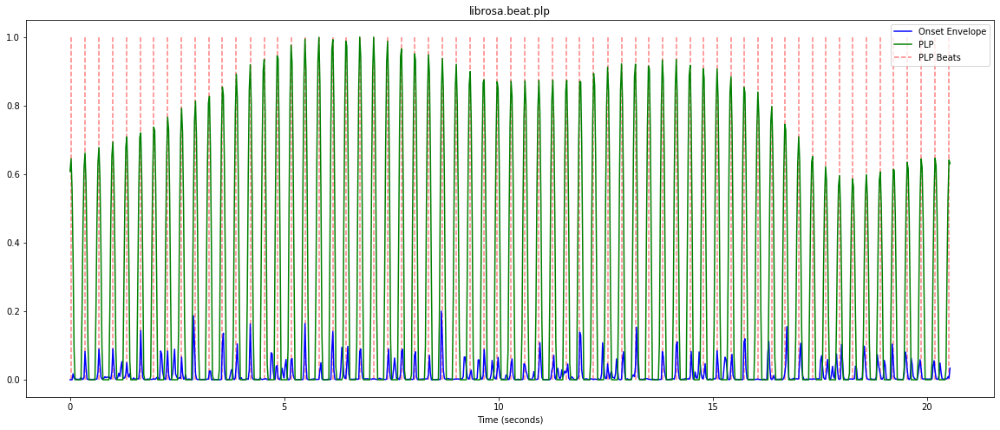

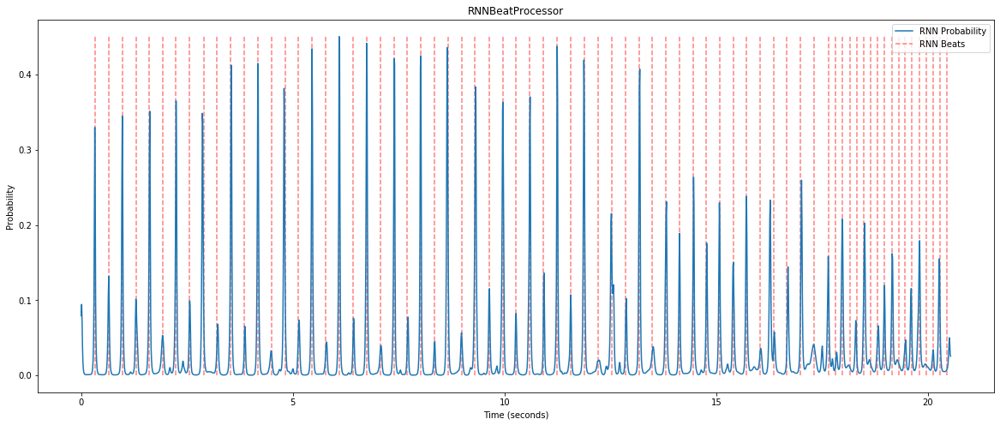

/Users/Xiao/opt/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


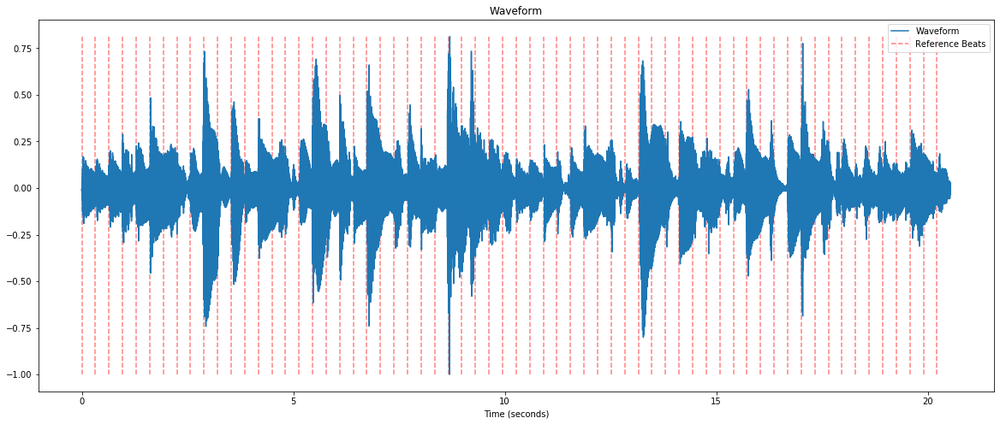

In [23]:
plot_and_sonify_outputs(best_track_sf)

Spectral Flux beat prediction:


RNN beat prediction:


Reference beats:


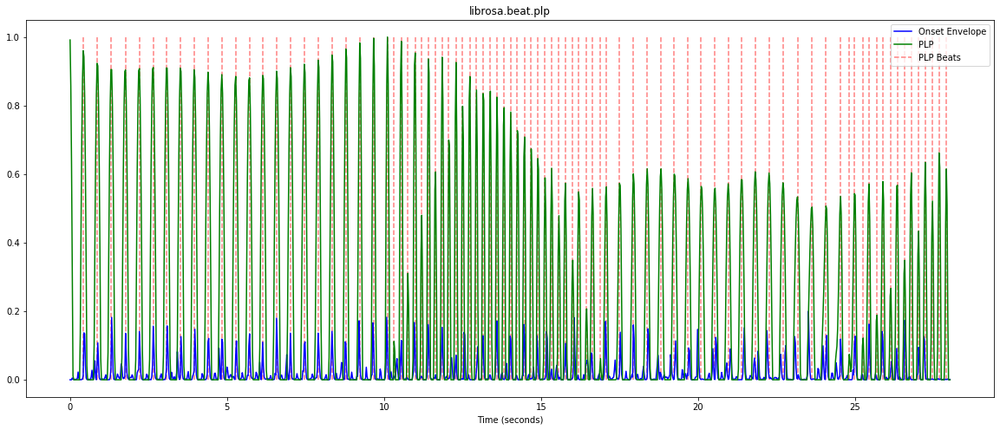

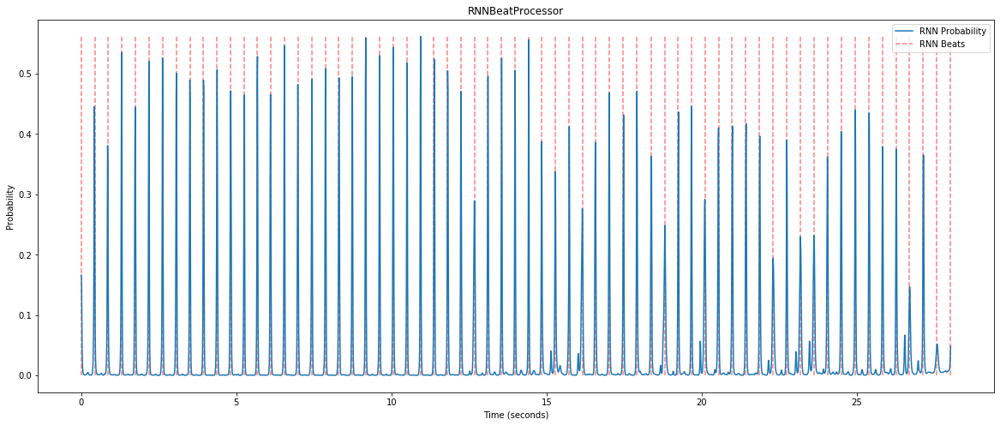

/Users/Xiao/opt/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


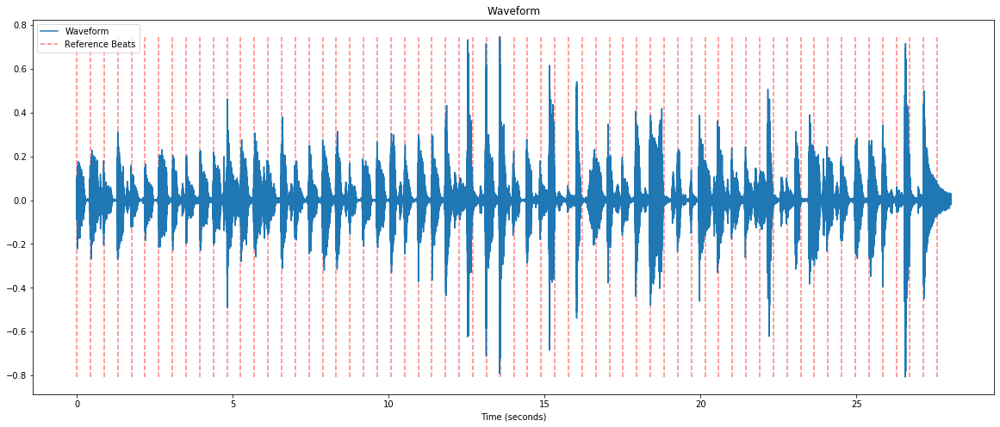

In [24]:
plot_and_sonify_outputs(best_track_ml)

Spectral Flux beat prediction:


RNN beat prediction:


Reference beats:


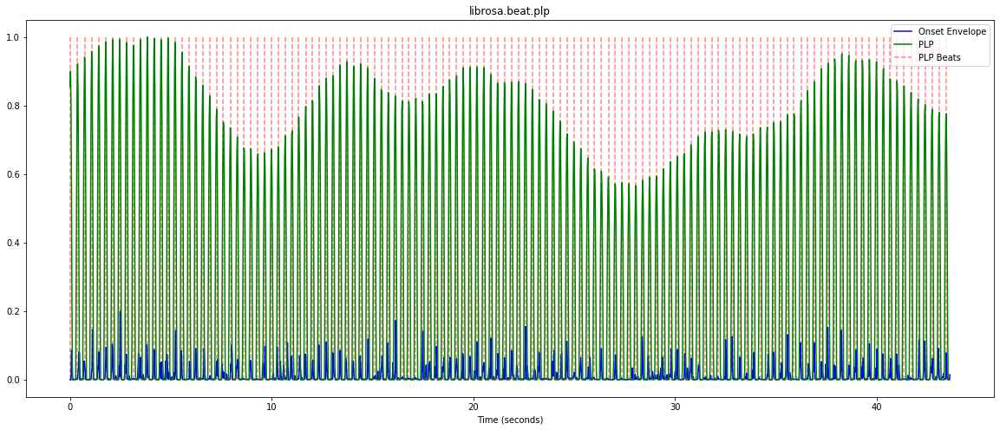

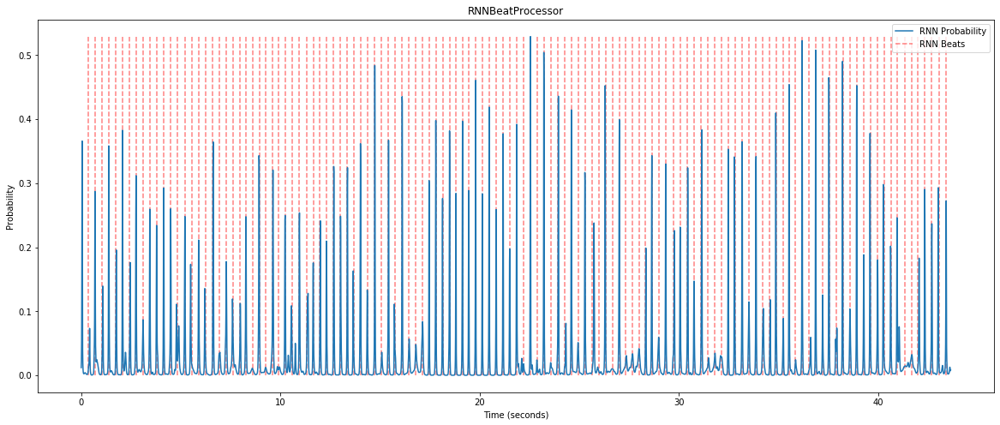

/Users/Xiao/opt/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


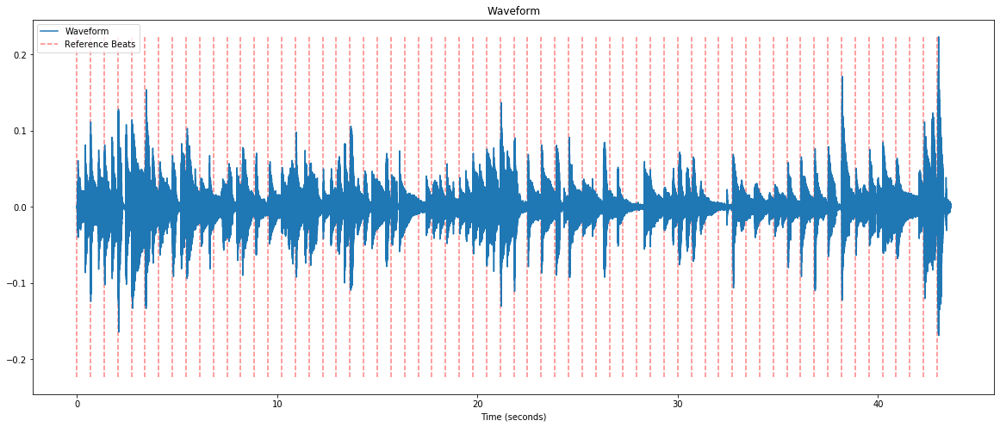

In [25]:
plot_and_sonify_outputs(worst_track_sf)

Spectral Flux beat prediction:


RNN beat prediction:


Reference beats:


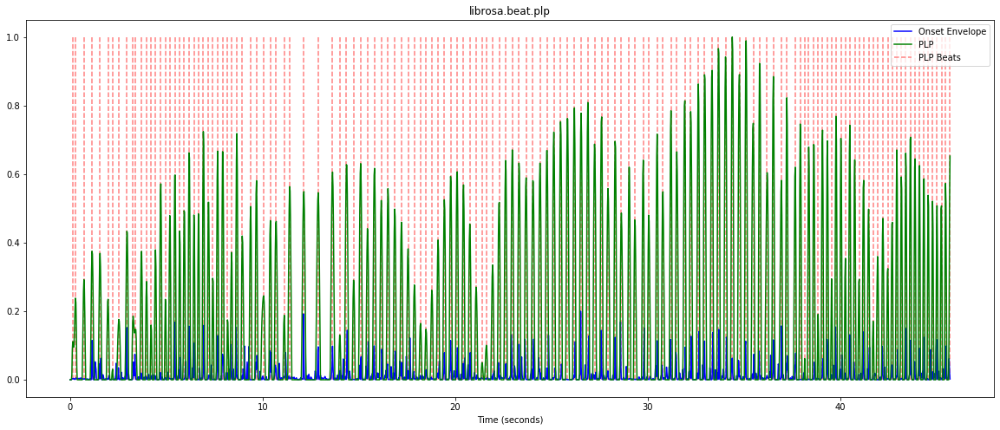

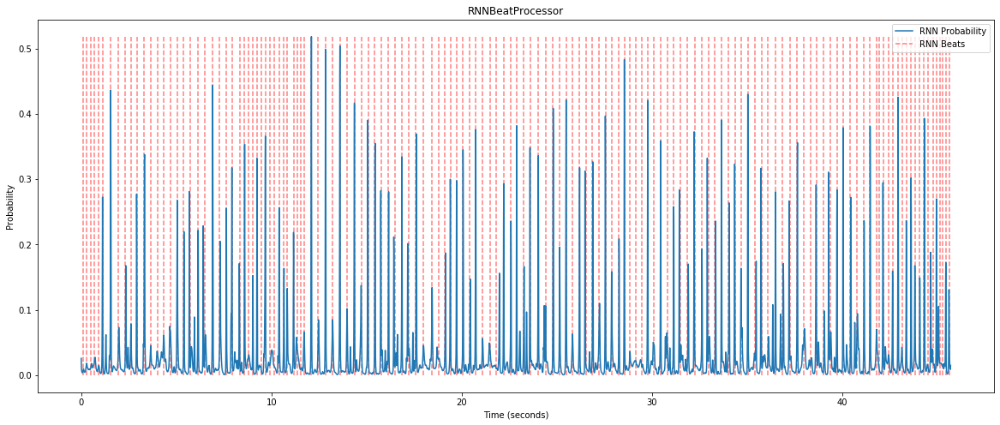

/Users/Xiao/opt/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


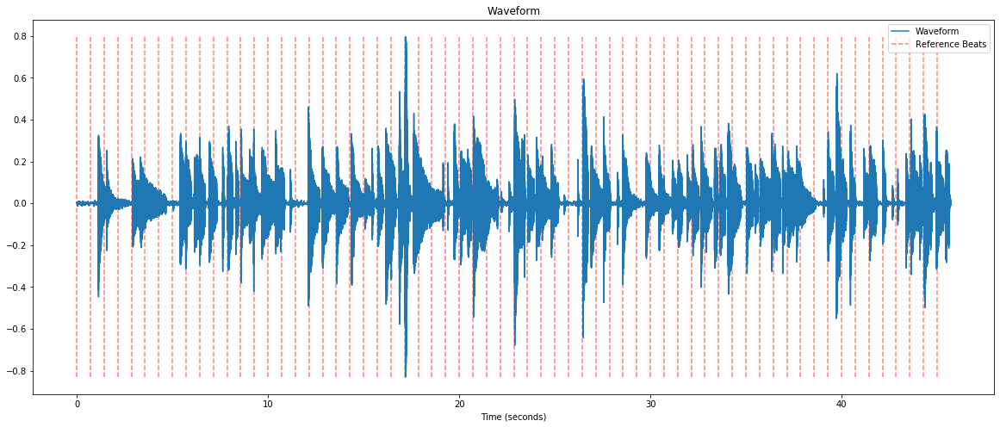

In [26]:
plot_and_sonify_outputs(worst_track_ml)

## Part 5: Analysis

Using the plots from part 3 and part 4, identify 3 different trends (e.g. if one algorithm performs better than the other overall, if one algorithm performs better on different splits than others, etc). Create additional plots or audio if necessary in your analysis. For each trend discuss what is happening and why it might be occuring.

#### Trend 1:
`
In general, the RNN approach performed better than Spectral Flux. But neither were spetacularly great in the task of beat tracking. 
`

#### Trend 2
`
When looking at results split by modes, it's shared across the two methods that accompaniments have better beat tracking performance compared to solo. This is probably due to the steady rhythm that comp style tracks have. The solo tracks typically have a range of different length notes. This can cause confusion for both algorithms. 
`

#### Trend 3
`
It's also shared across two methods that faster tempo tracks have better beat tracking results. This is very likely due to the fact the the two methods favor 8/16th notes, or more "local" notes, when deciding where the beats are. They don't quite know how to distinguish quater notes from eights notes, as well as dotted notes in a piece .
`

### Example

#### To illustrate what I mean in trend three, we can look at a very bad example below: 

Spectral Flux beat prediction:


RNN beat prediction:


Reference beats:


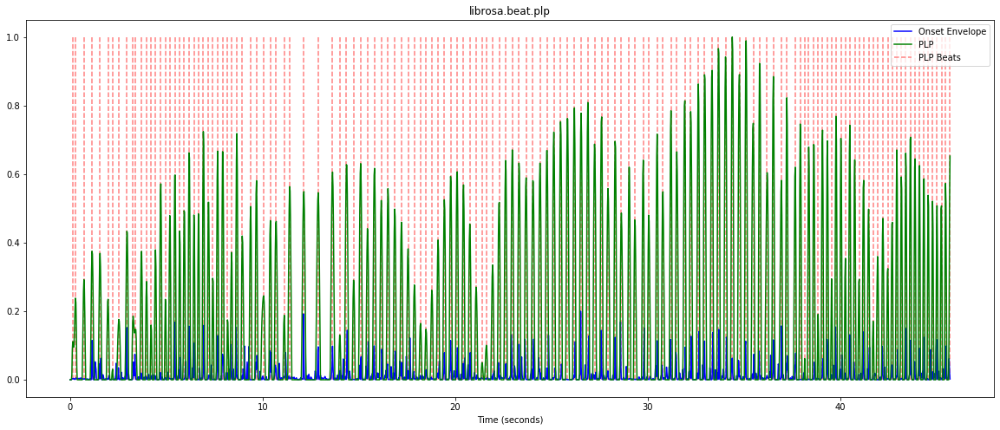

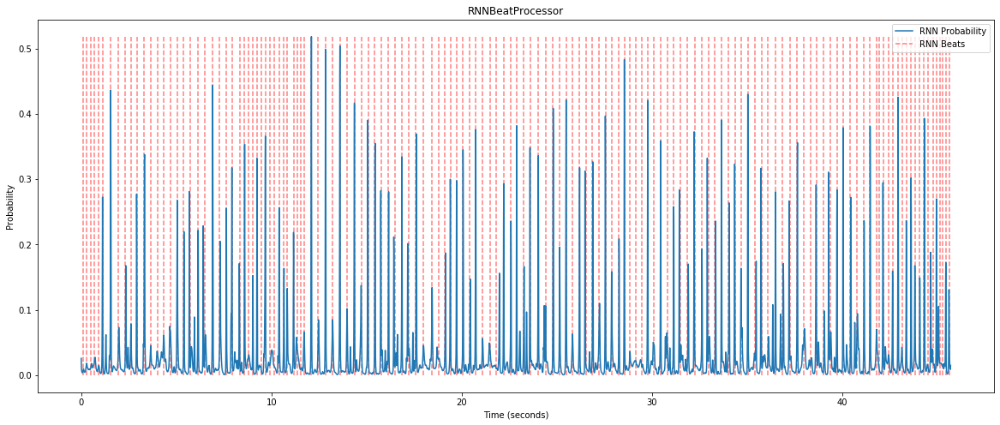

/Users/Xiao/opt/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


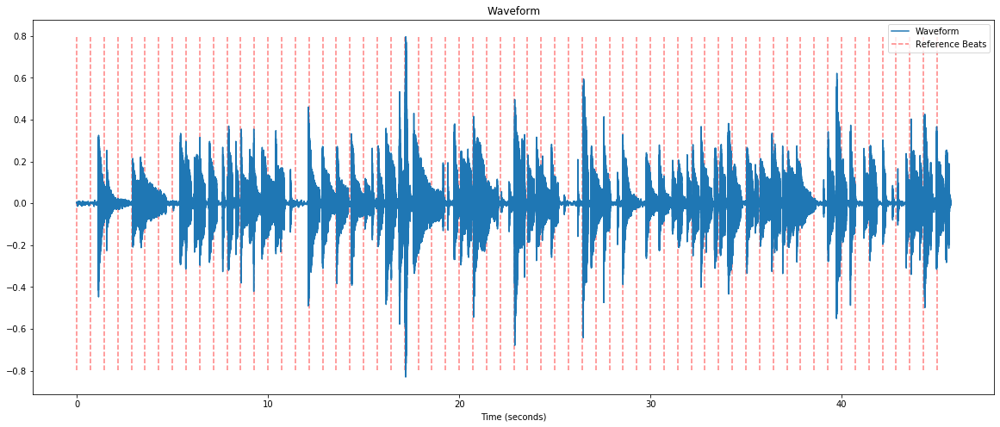

In [20]:
plot_and_sonify_outputs(worst_track_ml)

`
This is the worst performing RNN example. It also was pretty bad with spectral flux. First, it's a solo track that contains a lot of dotted quater notes. Both methods fail miserably to distinguish this. The beats identified are way too clumped together. For both methods, it seems that the PLP didn't quite convert the onset_envelopes/probabilities into perodic beats that makes human sense. I think additional tweaking of how the PLP algorithm should be done to favor longer periodicities, rather than the most salient ones that are too close together for beat placement to make sense.
`

`
Just to note, I also had a different implementation of the RNN beat tracking from the current one, which actually gave me slightly better results. 
`

`
Currently, I'm running a PLP over the probability curve that the RNN processor generated, then used the results for consequent computations. Before this, I tried simply raising the probability threshold to 0.1, by throwing away probabilities that are less than 0.1, without using PLP to obtain beat location. This method gave me a 0.60 F-score (over all of the tracks). Not a major improvement with PLP over the probability curve, but it's interesting that this technique works well... Using that method, the worst track is actually a piece that is completely syncopated. The model were able to guess to the tempo right, but they are all offset by an eighth note from the reference beats......
`